# The Effect of the Discarded Term in the Derivation of the VIX Implied Volatility Expansion

## 1. Single Exponential Models

In the single exponential models, the VIX option price can be approximated using the Black-Scholes price function and its derivatives with respect to the log-spot price. The formulas for the VIX call and VIX futures are given as follows
1. VIX call
\begin{align*}
c_{\mathrm{VIX}_T}
&:= C^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right) + \frac{\gamma_1}{2} \partial_x C^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right) + \frac{\gamma_2}{4} \partial_x^2 C^{\text{BS}} \left(x_P, \log(\kappa), \frac{ \widetilde{\sigma}}{2}\right) + \frac{\gamma_3}{8} \partial_x^3 C^{\text{BS}} \left(x_P, \log(\kappa), \frac{1}{2} \widetilde{\sigma}\right),
\end{align*}
where 
\begin{align*}
x_P := \frac{\mu_P}{2} + \frac{\sigma_P^2}{8}, && \widetilde{\sigma} = \frac{\sigma_P}{\sqrt{T}}.
\end{align*}
<!-- 2. VIX put option
\begin{align*}
p_{\mathrm{VIX}_T}
&:= P^{\text{BS}} \left( x_P, \log(\kappa), \frac{1}{2} \widetilde{\sigma}\right) + \frac{\gamma_1}{2} \partial_x P^{\text{BS}} \left(x_P, \log(\kappa), \frac{1}{2} \widetilde{\sigma}\right) + \frac{\gamma_2}{4} \partial_x^2 P^{\text{BS}} \left(x_P, \log(\kappa), \frac{1}{2} \widetilde{\sigma}\right) + \frac{\gamma_3}{8} \partial_x^3 P^{\text{BS}} \left(x_P, \log(\kappa), \frac{1}{2} \widetilde{\sigma}\right)
\end{align*} -->
2. VIX futures
\begin{align*}
F_{\mathrm{VIX}_T} := \mathrm{e}^{x_P} + \frac{\gamma_1}{2} \mathrm{e}^{x_P} + \frac{\gamma_2}{4} \mathrm{e}^{x_P} + \frac{\gamma_3}{8} \mathrm{e}^{x_P}.
\end{align*}

Thus, the VIX call price can be rewritten as follows

\begin{align*}
c_{\mathrm{VIX}_T}
&= C^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right) 
+ \left( \frac{\gamma_1}{2} + \frac{\gamma_2}{4} + \frac{\gamma_3}{8} \right) \partial_x C^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right)\\
&\quad+ \left( \frac{\gamma_2}{2 \widetilde{\sigma} T} + \frac{3 \gamma_3}{8 \widetilde{\sigma} T} - \frac{\gamma_3}{\widetilde{\sigma}^3 T^2} \left(x_P - \log(\kappa)\right) \right) \mathrm{Vega}^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right) \\
&= C^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right) 
+ \left( F_{\mathrm{VIX}_T} - x_P \right) \Phi \left(\frac{x_P - \log(\kappa)}{\frac{\widetilde{\sigma}}{2} \sqrt{T}} + \frac{\widetilde{\sigma} \sqrt{T}}{4} \right)\\
&\quad+ \left( \frac{\gamma_2}{2 \widetilde{\sigma} T} + \frac{3 \gamma_3}{8 \widetilde{\sigma} T} - \frac{\gamma_3}{\widetilde{\sigma}^3 T^2} \left(x_P - \log(\kappa)\right) \right) \mathrm{Vega}^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right)\\
&\approx C^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right) 
+ \left( \frac{\gamma_2}{2 \widetilde{\sigma} T} + \frac{3 \gamma_3}{8 \widetilde{\sigma} T} - \frac{\gamma_3}{\widetilde{\sigma}^3 T^2} \left(x_P - \log(\kappa)\right) \right) \mathrm{Vega}^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2}\right)\\
&= C^{\text{BS}} \left(x_P, \log(\kappa), \frac{\widetilde{\sigma}}{2} + \frac{\gamma_2}{2 \widetilde{\sigma} T} + \frac{3 \gamma_3}{8 \widetilde{\sigma} T} - \frac{\gamma_3}{\widetilde{\sigma}^3 T^2} \left(x_P - \log(\kappa)\right) \right),
\end{align*}

which is regarded as the first-order Taylor expansion around $\frac{\widetilde{\sigma}}{2}$. Thus, the first-order approximation of VIX implied volatility in the single exponential model is given by
\begin{align*}
\bar{\sigma}_I = \frac{\widetilde{\sigma}}{2} + \frac{\gamma_2}{2 \widetilde{\sigma} T} + \frac{3 \gamma_3}{8 \widetilde{\sigma} T} - \frac{\gamma_3}{\widetilde{\sigma}^3 T^2} \left(x_P - \log(\kappa)\right).
\end{align*}

We discard the term $\left( F_{\mathrm{VIX}_T} - x_P \right) \Phi \left(\frac{x_P - \log(\kappa)}{\frac{1}{2} \widetilde{\sigma} \sqrt{T}} + \frac{\widetilde{\sigma} \sqrt{T}}{4} \right)$ while deriving the VIX implied volatility expansion, which is expected to be small relative to the VIX call price. We next run numerical experiments to validate this assumption.

In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from standard_bergomi import StandardBergomi
from rough_bergomi import RoughBergomi

sns.set_theme("talk")
SEED = 777

We consider five different shapes of the initial forward variance curve $\xi_0(u)$, modelled using the Nelson-Siegel method:

* Flat: A constant variance over time.
* Contango: A variance curve that increases over time.
* Backwardation: A variance curve that decreases over time.
* Hump: A variance curve that increases for a while and then decreases.
* U-shape: A variance curve that decreases for a while and then increases.

In [3]:
shapes = ["flat", "contango", "backwardation", "hump", "ushape"]

beta0 = 0.235**2
beta1_contango = -0.02
beta2_contango = 0.01
tau1_contango = 0.5
tau2_contango = 2.0
beta1_backwardataion = 0.02
beta2_backwardataion = -0.01
tau1_backwardataion  = 0.5
tau2_backwardataion  = 2.0
beta1_hump = -0.02
beta2_hump =  0.06
tau1_hump  = 0.15
tau2_hump  = 0.35
beta1_ushape =  0.02
beta2_ushape = -0.06
tau1_ushape  = 0.15
tau2_ushape  = 0.35

def xi0_nelson_siegel(t, shape="flat"):
    if shape == "flat":
        return beta0 + np.zeros_like(t)
    elif shape == "contango":
        return beta0 + beta1_contango * np.exp(-t / tau1_contango) + beta2_contango * t / tau2_contango * np.exp(-t / tau2_contango)
    elif shape == "backwardation":
        return beta0 + beta1_backwardataion * np.exp(-t / tau1_backwardataion) + beta2_backwardataion * t / tau2_backwardataion * np.exp(-t / tau2_backwardataion)
    elif shape == "hump":
        return beta0 + beta1_hump * np.exp(-t / tau1_hump) + beta2_hump * t / tau2_hump * np.exp(-t / tau2_hump)
    elif shape == "ushape":
        return beta0 + beta1_ushape * np.exp(-t / tau1_ushape) + beta2_ushape * t / tau2_ushape * np.exp(-t / tau2_ushape)
    else:
        raise ValueError("Unknown shape")

### 1.1 Standard Bergomi Model

In [4]:
maturities = {
    "1M": 1.0 / 12.0,
    "3M": 3.0 / 12.0,
    "6M": 6.0 / 12.0
}

#### 1.1.1 Quality of the discarded term for different values of the strike price $\kappa$

In [5]:
base_params_b = {"omega": 2, "k": 1}
mat_values = list(maturities.values())

models_b = {
    s: StandardBergomi(
        **base_params_b, 
        xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
    )
    for s in shapes
}

In [6]:
kappas = np.linspace(0.1, 0.4, 10)

vix_call_b = {}
discarded_term_b = {}

for s in shapes:
    vix_call_b[s] = {}
    discarded_term_b[s] = {}
    
    for mat, T in maturities.items():

        price, term = models_b[s].vix_opt_price_expan(kappas, T, opttype=1, return_opt="all")

        vix_call_b[s][mat] = price
        discarded_term_b[s][mat] = term

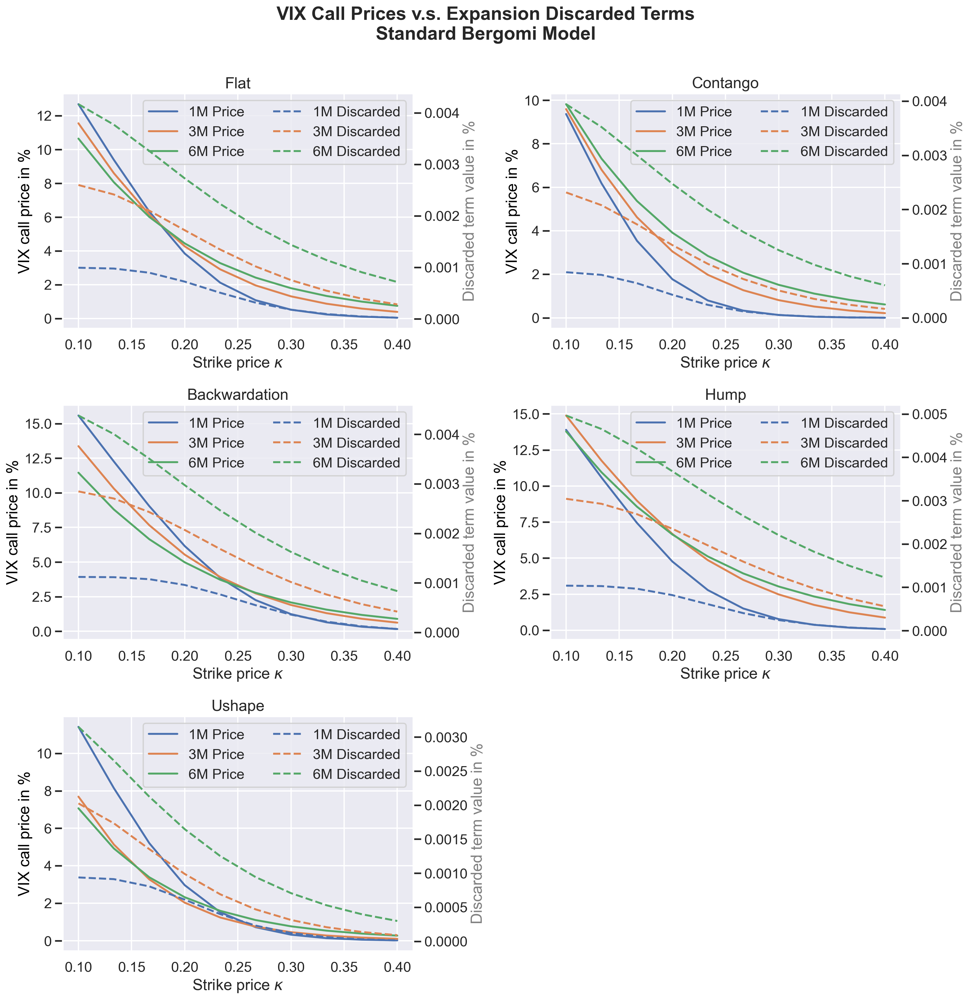

In [ ]:
n_shapes = len(shapes)
n_cols = 2
n_rows = int(np.ceil(n_shapes / float(n_cols)))
colors = plt.rcParams['axes.prop_cycle'].by_key()['color']

fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
axs_flat = axs.flat
for i, s in enumerate(shapes):
    ax1 = axs_flat[i]
    ax2 = ax1.twinx()
    
    price_dict = vix_call_b[s]
    disc_dict = discarded_term_b[s]
    
    for j, mat in enumerate(price_dict.keys()):

        c = colors[j % len(colors)]
        
        y_price = price_dict[mat] * 100
        y_disc = disc_dict[mat] * 100
        
        ax1.plot(kappas, y_price, color=c, label=f"{mat} Price")
        ax2.plot(kappas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

    ax1.grid(True)
    ax2.grid(False)
    ax1.set_title(fr"{s.capitalize()}")
    ax1.set_xlabel(r"Strike price $\kappa$")
    ax1.set_ylabel("VIX call price in %", color='black')
    ax2.set_ylabel("Discarded term value in %", color='gray')

    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

for j in range(n_shapes, len(axs_flat)):
    axs_flat[j].axis("off")

fig.suptitle("VIX Call Prices v.s. Expansion Discarded Terms\nStandard Bergomi Model", fontweight='bold', y=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.9])
plt.show()

#### 1.1.2 Quality of the discarded term for different values of the vol-of-variance $\omega$

In [8]:
omegas = np.linspace(0.5, 6, 10)
base_k = 1

models_b = {
    s: {
        w: StandardBergomi(
            omega=w, k=base_k, 
            xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
        )
        for w in omegas
    }
    for s in shapes
}

In [9]:
for s in shapes:
    for mat, T in maturities.items():
        
        prices_list = []
        terms_list = []
        
        for w in omegas:
            model = models_b[s][w]
            
            atm_kappa = model.vix_opt_price_expan(0, T, opttype=0)
            p, t = model.vix_opt_price_expan(atm_kappa, T, opttype=1, return_opt="all")
            
            prices_list.append(p if np.isscalar(p) else p.item())
            terms_list.append(t if np.isscalar(t) else t.item())

        vix_call_b[s][mat] = np.array(prices_list)
        discarded_term_b[s][mat] = np.array(terms_list)

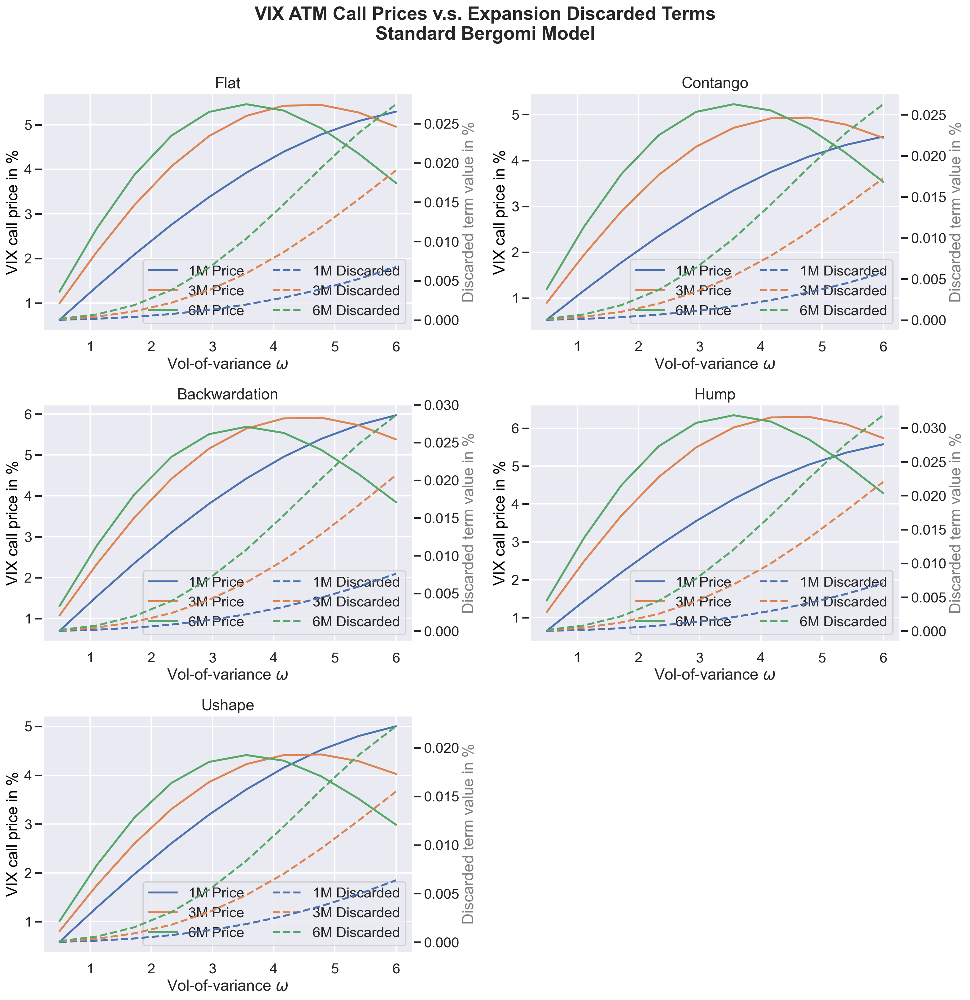

In [ ]:
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
axs_flat = axs.flat
for i, s in enumerate(shapes):
    ax1 = axs_flat[i]
    ax2 = ax1.twinx()
    
    price_dict = vix_call_b[s]
    disc_dict = discarded_term_b[s]
    
    for j, mat in enumerate(price_dict.keys()):

        c = colors[j % len(colors)]
        
        y_price = price_dict[mat] * 100
        y_disc = disc_dict[mat] * 100
        
        ax1.plot(omegas, y_price, color=c, label=f"{mat} Price")
        ax2.plot(omegas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

    ax1.grid(True)
    ax2.grid(False)
    ax1.set_title(fr"{s.capitalize()}")
    ax1.set_xlabel(r"Vol-of-variance $\omega$")
    ax1.set_ylabel("VIX call price in %", color='black')
    ax2.set_ylabel("Discarded term value in %", color='gray')
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

for j in range(n_shapes, len(axs_flat)):
    axs_flat[j].axis("off")

fig.suptitle("VIX ATM Call Prices v.s. Expansion Discarded Terms\nStandard Bergomi Model", fontweight='bold', y=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.9])
plt.show()

#### 1.1.3 Quality of the discarded term for different values of the mean-reversion strength $k$

In [11]:
base_omega = 2
ks = np.linspace(0.5, 15, 10)

models_b = {
    s: {
        k: StandardBergomi(
            omega=base_omega, k=k, 
            xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
        )
        for k in ks
    }
    for s in shapes
}

In [12]:
vix_call_b = {s: {} for s in shapes}
discarded_term_b = {s: {} for s in shapes}

for s in shapes:
    for mat, T in maturities.items():
        
        prices_list = []
        terms_list = []
        
        for k in ks:
            model = models_b[s][k]
            
            atm_kappa = model.vix_opt_price_expan(0, T, opttype=0)
            p, t = model.vix_opt_price_expan(atm_kappa, T, opttype=1, return_opt="all")
            
            prices_list.append(p if np.isscalar(p) else p.item())
            terms_list.append(t if np.isscalar(t) else t.item())

        vix_call_b[s][mat] = np.array(prices_list)
        discarded_term_b[s][mat] = np.array(terms_list)

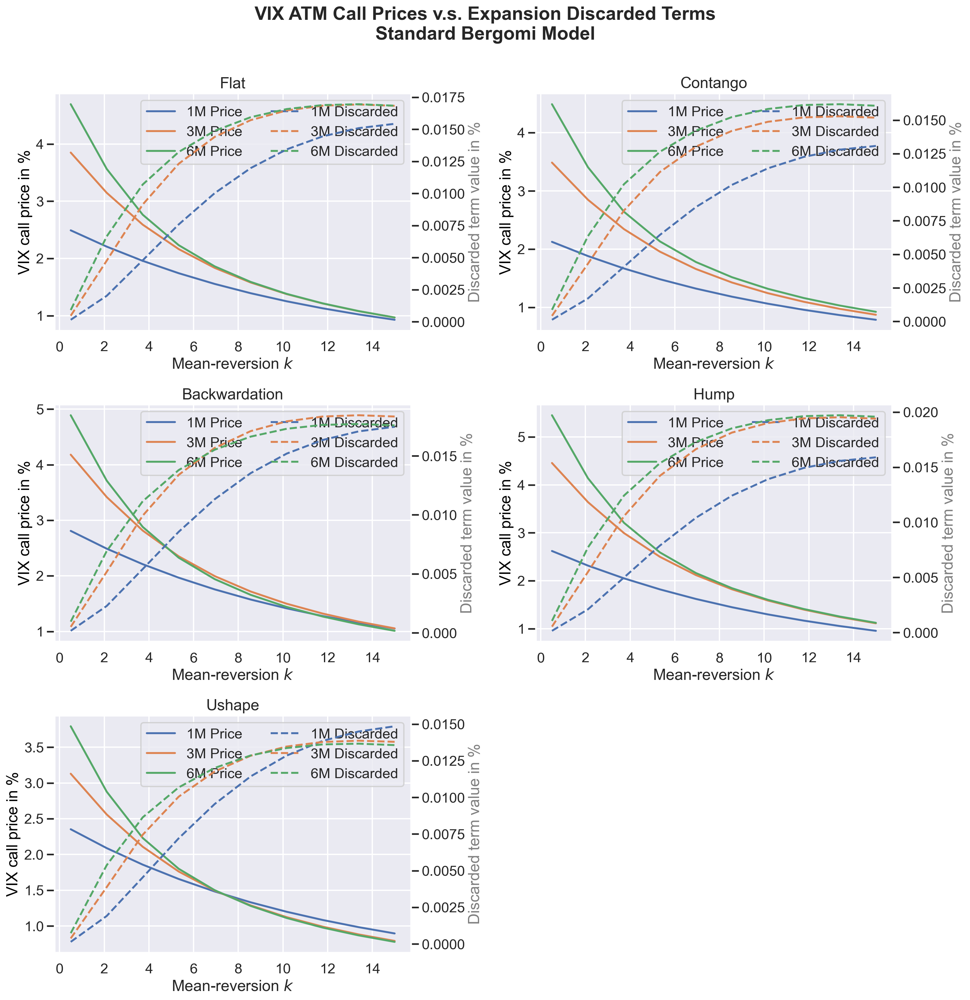

In [ ]:
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
axs_flat = axs.flat

for i, s in enumerate(shapes):
    ax1 = axs_flat[i]
    ax2 = ax1.twinx()
    
    price_dict = vix_call_b[s]
    disc_dict = discarded_term_b[s]
    
    for j, mat in enumerate(price_dict.keys()):

        c = colors[j % len(colors)]
        
        y_price = price_dict[mat] * 100
        y_disc = disc_dict[mat] * 100
        
        ax1.plot(ks, y_price, color=c, label=f"{mat} Price")
        ax2.plot(ks, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

    ax1.grid(True)
    ax2.grid(False)
    ax1.set_title( f"{s.capitalize()}")
    ax1.set_xlabel(r"Mean-reversion $k$")
    ax1.set_ylabel("VIX call price in %", color='black')
    ax2.set_ylabel("Discarded term value in %", color='gray')
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

for j in range(n_shapes, len(axs_flat)):
    axs_flat[j].axis("off")

fig.suptitle("VIX ATM Call Prices v.s. Expansion Discarded Terms\nStandard Bergomi Model", fontweight='bold', y=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.9])
plt.show()

### 1.2 Rough Bergomi Model

#### 1.2.1 Quality of the discarded term for different values of the strike price $\kappa$

In [14]:
base_params_rb = {"eta": 1, "H": 0.1}

models_rb = {
    s: RoughBergomi(
        **base_params_rb, 
        xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
    )
    for s in shapes
}

In [ ]:
vix_call_rb = {}
discarded_term_rb = {}
for s in shapes:
    vix_call_rb[s] = {}
    discarded_term_rb[s] = {}
    
    for mat, T in maturities.items():

        price, term = models_rb[s].vix_opt_price_expan(kappas, T, opttype=1, return_opt="all")

        vix_call_rb[s][mat] = price
        discarded_term_rb[s][mat] = term

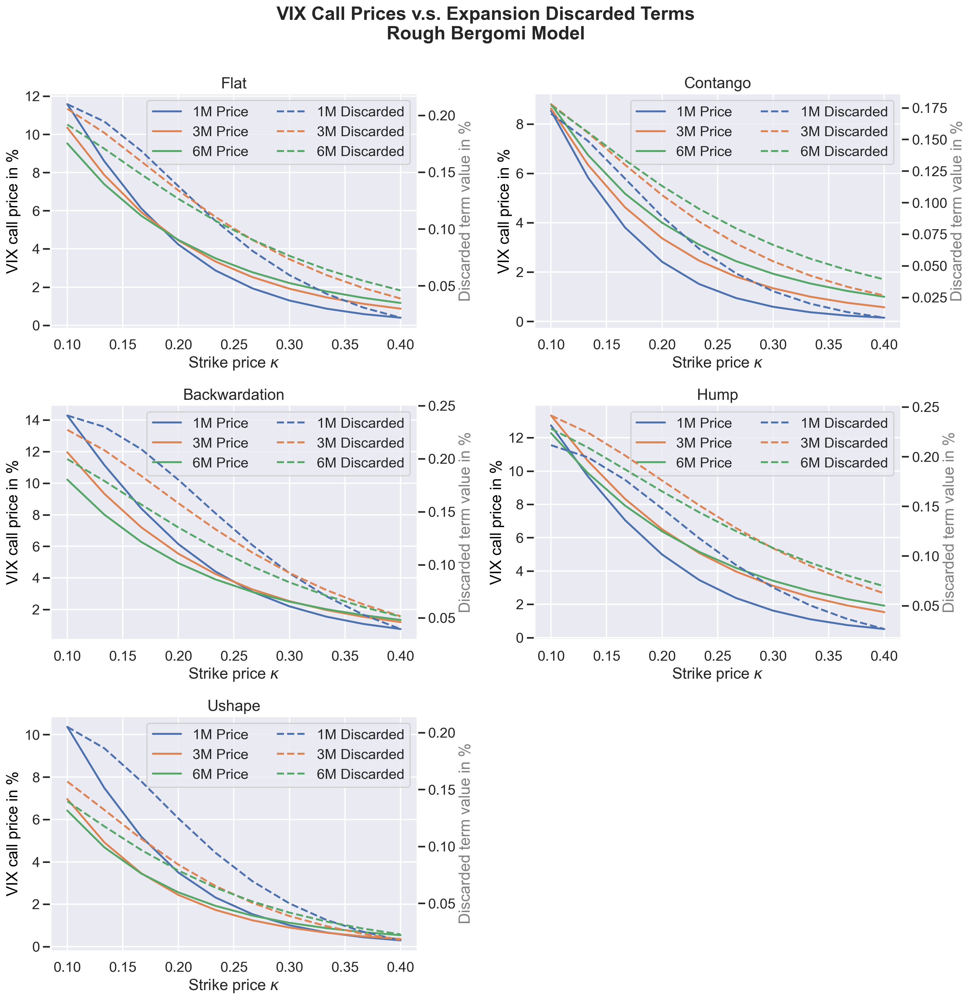

In [ ]:
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
axs_flat = axs.flat

for i, s in enumerate(shapes):
    ax1 = axs_flat[i]
    ax2 = ax1.twinx()
    
    price_dict = vix_call_rb[s]
    disc_dict = discarded_term_rb[s]
    
    for j, mat in enumerate(price_dict.keys()):
        c = colors[j % len(colors)]
        
        y_price = price_dict[mat] * 100
        y_disc = disc_dict[mat] * 100
        
        ax1.plot(kappas, y_price, color=c, label=f"{mat} Price")
        ax2.plot(kappas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

    ax1.grid(True)
    ax2.grid(False)
    ax1.set_title( f"{s.capitalize()}")
    ax1.set_xlabel(r"Strike price $\kappa$")
    ax1.set_ylabel("VIX call price in %", color='black')
    ax2.set_ylabel("Discarded term value in %", color='gray')
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

for j in range(n_shapes, len(axs_flat)):
    axs_flat[j].axis("off")

fig.suptitle("VIX Call Prices v.s. Expansion Discarded Terms\nRough Bergomi Model", fontweight='bold', y=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.9])
plt.show()

#### 1.2.2 Quality of the discarded term for different values of the vol-of-variance $\eta$

In [17]:
etas = np.linspace(0.1, 1.5, 10)
base_H = 0.1

models_rb = {
    s: {
        e: RoughBergomi(
            eta=e, H=base_H, 
            xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
        )
        for e in etas
    }
    for s in shapes
}

In [ ]:
vix_call_rb = {s: {} for s in shapes}
discarded_term_rb = {s: {} for s in shapes}
for s in shapes:
    for mat, T in maturities.items():
        
        prices_list = []
        terms_list = []
        
        for e in etas:
            model = models_rb[s][e]
            
            atm_kappa = model.vix_opt_price_expan(0, T, opttype=0)
            p, t = model.vix_opt_price_expan(atm_kappa, T, opttype=1, return_opt="all")
            
            prices_list.append(p if np.isscalar(p) else p.item())
            terms_list.append(t if np.isscalar(t) else t.item())

        vix_call_rb[s][mat] = np.array(prices_list)
        discarded_term_rb[s][mat] = np.array(terms_list)

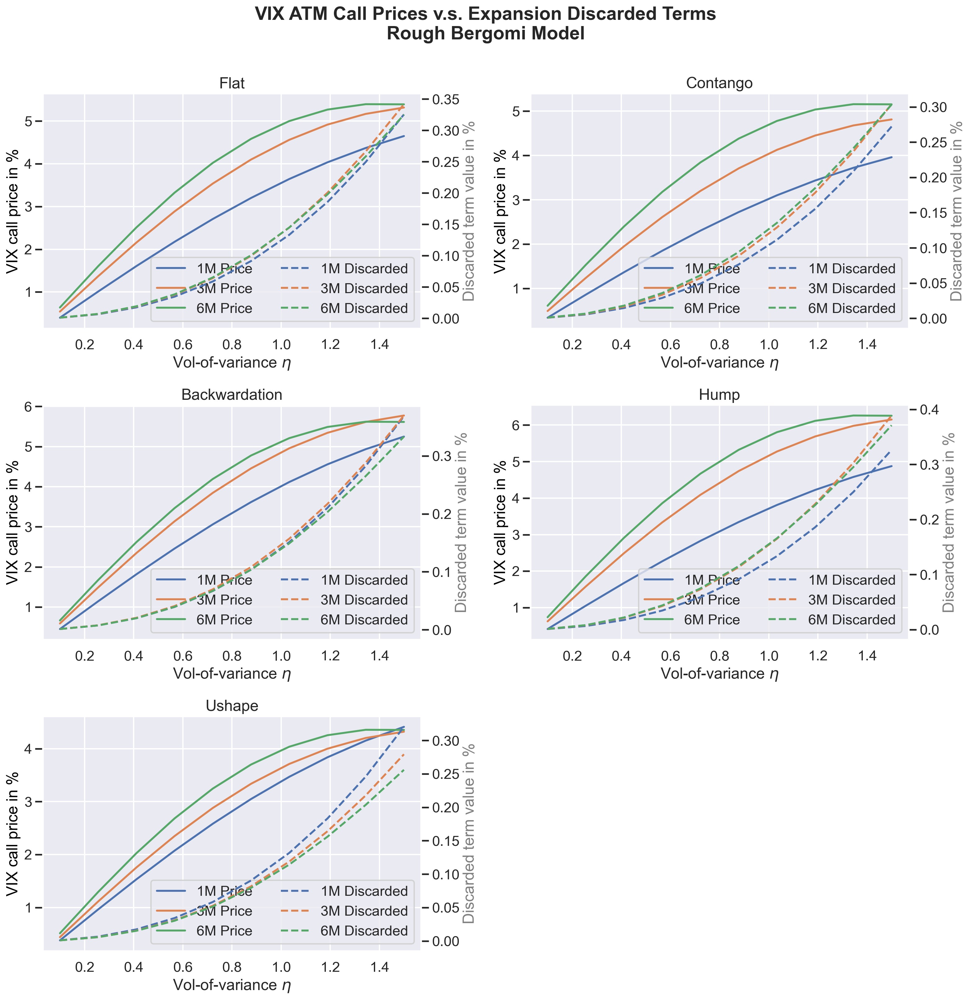

In [ ]:
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
axs_flat = axs.flat
for i, s in enumerate(shapes):
    ax1 = axs_flat[i]
    ax2 = ax1.twinx()
    
    price_dict = vix_call_rb[s]
    disc_dict = discarded_term_rb[s]
    
    for j, mat in enumerate(price_dict.keys()):
        c = colors[j % len(colors)]
        
        y_price = price_dict[mat] * 100
        y_disc = disc_dict[mat] * 100
        
        ax1.plot(etas, y_price, color=c, label=f"{mat} Price")
        ax2.plot(etas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

    ax1.grid(True)
    ax2.grid(False)
    ax1.set_title( f"{s.capitalize()}")
    ax1.set_xlabel(r"Vol-of-variance $\eta$")
    ax1.set_ylabel("VIX call price in %", color='black')
    ax2.set_ylabel("Discarded term value in %", color='gray')
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

for j in range(n_shapes, len(axs_flat)):
    axs_flat[j].axis("off")

fig.suptitle("VIX ATM Call Prices v.s. Expansion Discarded Terms\nRough Bergomi Model", fontweight='bold', y=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.9])
plt.show()

#### 1.2.3 Quality of the discarded term for different values of $H$

In [20]:
base_eta = 1
Hs = np.linspace(0.05, 0.4, 10)

models_rb = {
    s: {
        h: RoughBergomi(
            eta=base_eta, H=h, 
            xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
        )
        for h in Hs
    }
    for s in shapes
}

In [ ]:
vix_call_rb = {s: {} for s in shapes}
discarded_term_rb = {s: {} for s in shapes}
for s in shapes:
    for mat, T in maturities.items():
        
        prices_list = []
        terms_list = []
        
        for h in Hs:
            model = models_rb[s][h]
            
            atm_kappa = model.vix_opt_price_expan(0, T, opttype=0)
            p, t = model.vix_opt_price_expan(atm_kappa, T, opttype=1, return_opt="all")
            
            prices_list.append(p if np.isscalar(p) else p.item())
            terms_list.append(t if np.isscalar(t) else t.item())

        vix_call_rb[s][mat] = np.array(prices_list)
        discarded_term_rb[s][mat] = np.array(terms_list)

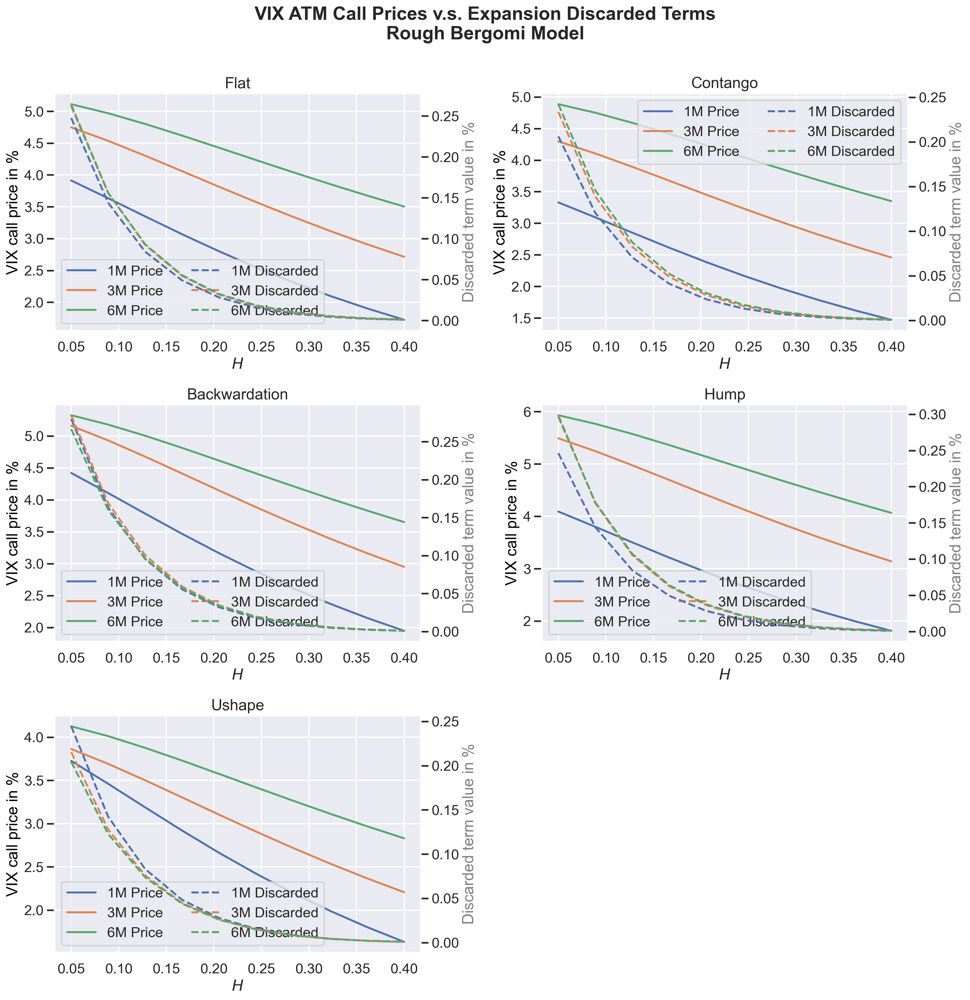

In [ ]:
fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
axs_flat = axs.flat
for i, s in enumerate(shapes):
    ax1 = axs_flat[i]
    ax2 = ax1.twinx()
    
    price_dict = vix_call_rb[s]
    disc_dict = discarded_term_rb[s]
    
    for j, mat in enumerate(price_dict.keys()):
        c = colors[j % len(colors)]
        
        y_price = price_dict[mat] * 100
        y_disc = disc_dict[mat] * 100
        
        ax1.plot(Hs, y_price, color=c, label=f"{mat} Price")
        ax2.plot(Hs, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

    ax1.grid(True)
    ax2.grid(False)
    ax1.set_title(f"{s.capitalize()}")
    ax1.set_xlabel(r"$H$")
    ax1.set_ylabel("VIX call price in %", color='black')
    ax2.set_ylabel("Discarded term value in %", color='gray')
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

for j in range(n_shapes, len(axs_flat)):
    axs_flat[j].axis("off")

fig.suptitle("VIX ATM Call Prices v.s. Expansion Discarded Terms\nRough Bergomi Model", fontweight='bold', y=0.9)

plt.tight_layout(rect=[0, 0, 1, 0.9])
plt.show()

## 2. Mixed Exponential Models

In the mixed exponential models, mixed standard Bergomi and mixed rough Bergomi moxel, the VIX option price can be approximated using the following formula, assuming $\sigma_{P,2} \le \sigma_{P,1}$,
1. VIX call
\begin{align*}
P_N^\text{Call} &:= c_0 \bar{I}_N (B) + c_1 \bar{I}_{1,N} (B) + c_2 \bar{I}_{2,N} (B) + c_3 \bar{I}_{3,N} (B) - \kappa \Phi(-A),
\end{align*}
where the coefficients $(c_i)_{i = 0, 1, 2, 3}$ are given by
\begin{align*}
c_0 &:= \left(1 + \frac{1}{2} \gamma_{1,2} + \frac{1}{4} \gamma_{2,2} + \frac{1}{8} \gamma_{3,2} \right) a\\
c_1 &:= \left(\gamma_{1,1} - \gamma_{1,2} + \gamma_{2,1} \frac{\sigma_{P,2}}{2 \sigma_{P,1}} - \gamma_{2,2} \left(1 - \frac{\sigma_{P,1}}{2 \sigma_{P,2}} \right) + \gamma_{3,1} \frac{\sigma_{P,2}^2}{4 \sigma_{P,1}^2} - \gamma_{3,2} \left(\frac{3}{4} - \frac{\sigma_{P,1}}{2 \sigma_{P,2}}\right) \right) a,\\
c_2 &:= \left(\gamma_{2,1} \left(1 - \frac{\sigma_{P,2}}{\sigma_{P,1}} \right) + \gamma_{2,2} \left(1 -  \frac{\sigma_{P,1}}{\sigma_{P,2}}\right) + \gamma_{3,1} \left( \frac{\sigma_{P,2}}{\sigma_{P,1}} - \frac{\sigma_{P,2}^2}{\sigma_{P,1}^2} \right) + \gamma_{3,2} \left( \frac{3}{2} - \frac{2 \sigma_{P,1}}{\sigma_{P,2}} + \frac{\sigma_{P,1}^2}{2\sigma_{P,2}^2} \right) \right) a\\
c_3 &:= \left(\gamma_{3,1} \left(1 - \frac{2 \sigma_{P,2}}{\sigma_{P,1}} + \frac{\sigma_{P,2}^2}{\sigma_{P,1}^2} \right) - \gamma_{3,2} \left(1 - \frac{2 \sigma_{P,1}}{\sigma_{P,2}} + \frac{\sigma_{P,1}^2}{\sigma_{P,2}^2} \right)\right) a,
\end{align*}
and the partial derivatives of $\bar{I}_N (B)$ with respect to $\mu_{P,1}$ are derived as follows
\begin{align*}
\bar{I}_{i,N} (B) &:= \partial_{\mu_{P,1}}^i \omega_0 \Phi(-B) + \sum_{n=1}^N \partial_{\mu_{P,1}}^i \omega_n \text{He}_{n-1} (B) \phi (B).
\end{align*}
2. VIX futures
\begin{align*}
P^F = c_0 \omega_0 + c_1 \partial_{\mu_{P,1}} \omega_0 + c_2 \partial_{\mu_{P,1}}^2 \omega_0 + c_3 \partial_{\mu_{P,1}}^3 \omega_0.
\end{align*}

Thus, the VIX call price can be simplified as follows
\begin{align*}
P_N^\text{Call} 
= P^F \Phi(-B) - \kappa \Phi(-A) + \sum_{n=1}^N \left(c_0 \omega_n + c_1 \partial_{\mu_{P,1}} \omega_n + c_2 \partial_{\mu_{P,1}}^2 \omega_n + c_3 \partial_{\mu_{P,1}}^3 \omega_n \right) \text{He}_{n-1} (B) \phi (B).
\end{align*}

Since we have $-B+A = \frac{\sigma_{P,2}}{2 \sqrt{T}}$, we consider rewriting the formula using the Black-Scholes price function as follows
1. New log-spot price, unchanged log-strike price.
\begin{align*}
P_{N}^\text{Call}
&= C^\text{BS} \left(x_1, k_1, \frac{\widetilde{\sigma}}{2} \right) + \left(P^F - \mathrm{e}^{x_1} \right) \Phi(-B)\\
&\quad+ \sum_{n=1}^N \left(c_0 \omega_n + c_1 \partial_{\mu_{P,1}} \omega_n + c_2 \partial_{\mu_{P,1}}^2 \omega_n + c_3 \partial_{\mu_{P,1}}^3 \omega_n \right) \text{He}_{n-1} (B) \phi (B),
\end{align*}
where
\begin{align*}
x_1 := k_1 - \frac{B \sigma_{P,2}}{2} - \frac{\sigma_{P,2}^2}{8}, && k_1 := \ln (\kappa), && \widetilde{\sigma} := \frac{\sigma_{P,2}}{\sqrt{T}}.
\end{align*}
2. Unchanged log-spot price, new log-strike price.
\begin{align*}
P_{N}^\text{Call} &= C^\text{BS} \left(x_2, k_2, \frac{\widetilde{\sigma}}{2} \right) + \left(\mathrm{e}^{k_2} - \kappa\right) \Phi(-A)\\
&\quad+ \sum_{n=1}^N \left(c_0 \omega_n + c_1 \partial_{\mu_{P,1}} \omega_n + c_2 \partial_{\mu_{P,1}}^2 \omega_n + c_3 \partial_{\mu_{P,1}}^3 \omega_n \right) \text{He}_{n-1} (B) \phi (B),
\end{align*}
where
\begin{align*}
x_2 := \ln \left(P^F\right), && k_2 := x_2 + \frac{B \sigma_{P,2}}{2} + \frac{\sigma_{P,2}^2}{8}.
\end{align*}
3. New log-spot price, new log-strike price.
\begin{align*}
P_{N}^\text{Call} &= C^\text{BS} \left(x_3, k_3, \frac{\widetilde{\sigma}}{2} \right) + \left(P^F - \mathrm{e}^{x_3} \right) \Phi(-B) + \left(\mathrm{e}^{k_3} - \kappa\right) \Phi(-A)\\
&\quad+ \sum_{n=1}^N \left(c_0 \omega_n + c_1 \partial_{\mu_{P,1}} \omega_n + c_2 \partial_{\mu_{P,1}}^2 \omega_n + c_3 \partial_{\mu_{P,1}}^3 \omega_n \right) \text{He}_{n-1} (B) \phi (B),
\end{align*}
where
\begin{align*}
x_3 := \frac{1}{2} \left(x_1 + x_2 \right), && k_3 := \frac{1}{2} \left( k_1 + k_2 \right).
\end{align*}

When deriving the VIX implied volatility using the same technique as in the previous section, we rewrite the VIX call price as a Taylor expansion around $\widetilde{\sigma}/2$. The discarded terms are then given as follows
1. New log-spot price, unchanged log-strike price.
\begin{align*}
\left(P^F - \mathrm{e}^{x_1} \right) \Phi(-B).
\end{align*}
2. Unchanged log-spot price, new log-strike price.
\begin{align*}
\left(\mathrm{e}^{k_2} - \kappa\right) \Phi(-A).
\end{align*}
3. New log-spot price, new log-strike price.
\begin{align*}
\left(P^F - \mathrm{e}^{x_3} \right) \Phi(-B) + \left(\mathrm{e}^{k_3} - \kappa\right) \Phi(-A).
\end{align*}


### 2.1 Mixed Standard Bergomi Model

In [23]:
base_params_mb = {"omega": 10, "k": 1}
mat_values = list(maturities.values())
omega2 = 2
lbd_b = 0.2
rule = -1
n_max = 20
n_mc = 10**6

models_mb = {
    s: StandardBergomi(
        **base_params_mb, 
        xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
    )
    for s in shapes
}

In [24]:
vix_call_mb = {}
discarded_term_mb = {}

for s in shapes:
    vix_call_mb[s] = {}
    discarded_term_mb[s] = {}
    
    for mat, T in maturities.items():

        price, term = models_mb[s].vix_opt_price_expan_mixed(kappas, T, rule, omega2, lbd_b, 1, n_max, n_mc, return_opt="all")

        vix_call_mb[s][mat] = price
        discarded_term_mb[s][mat] = term

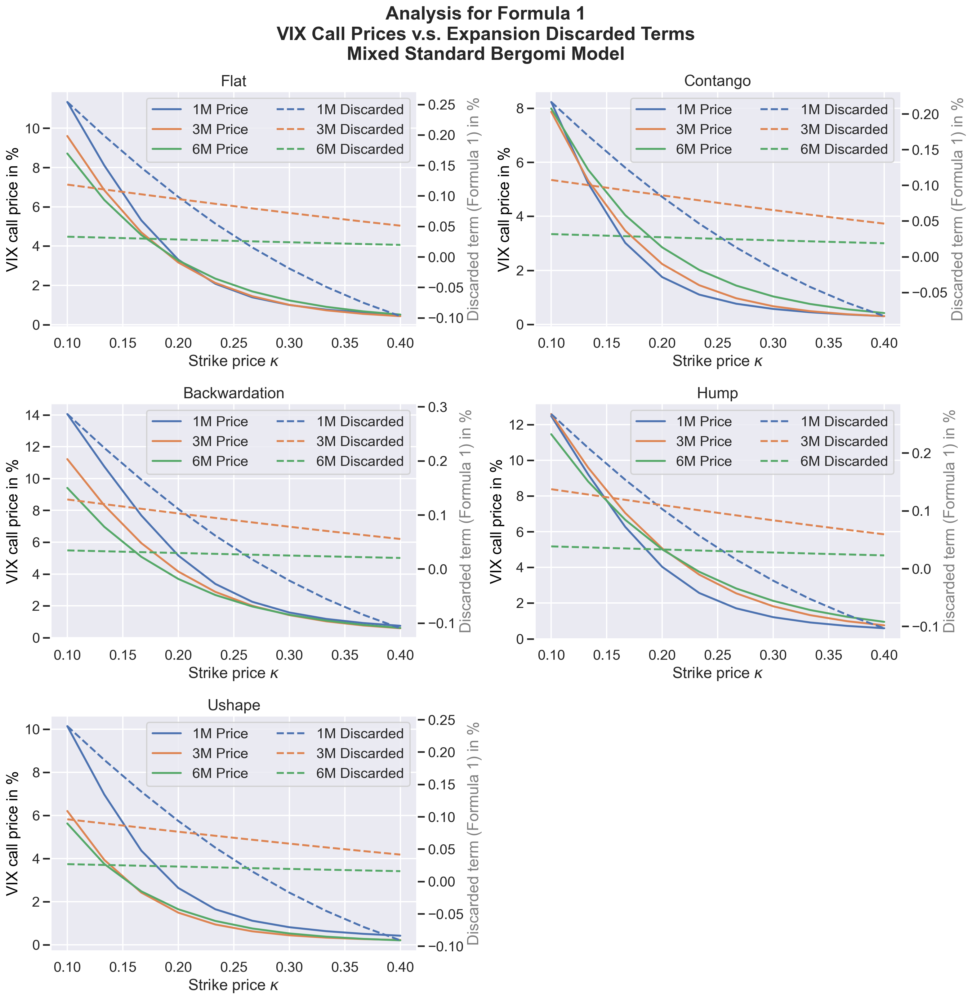

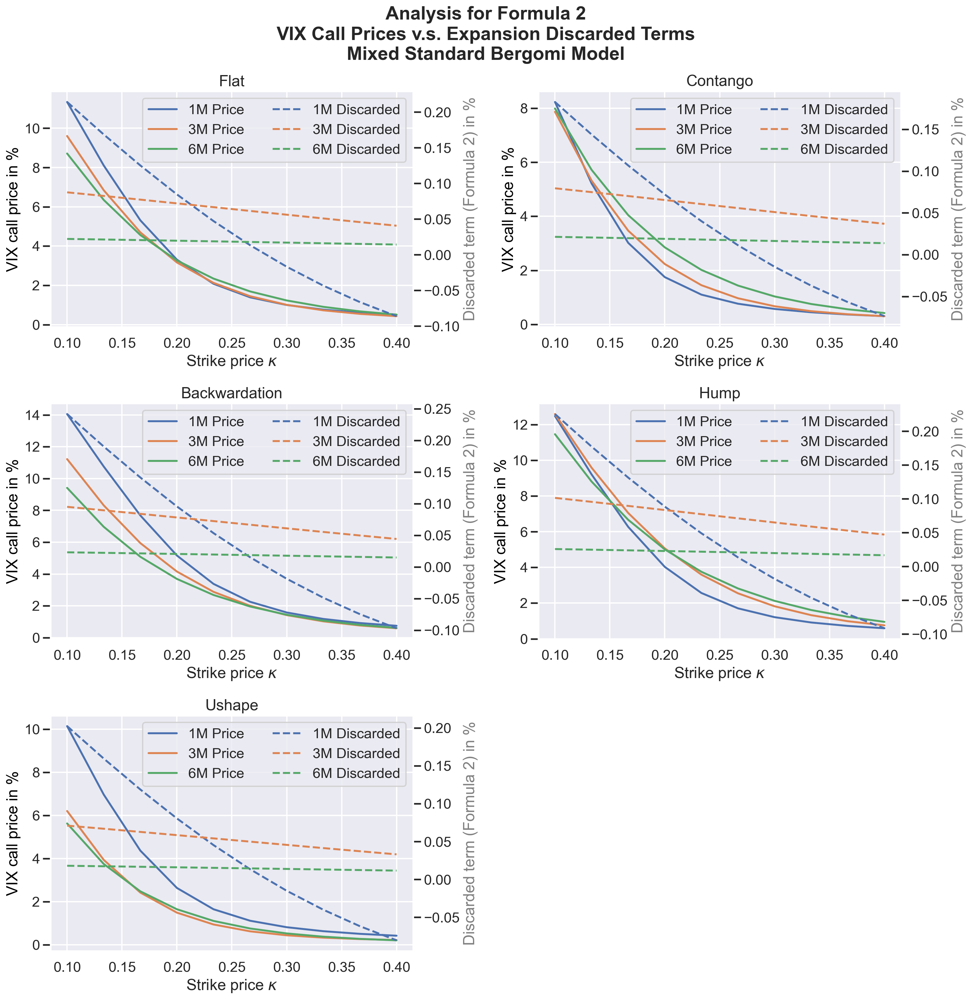

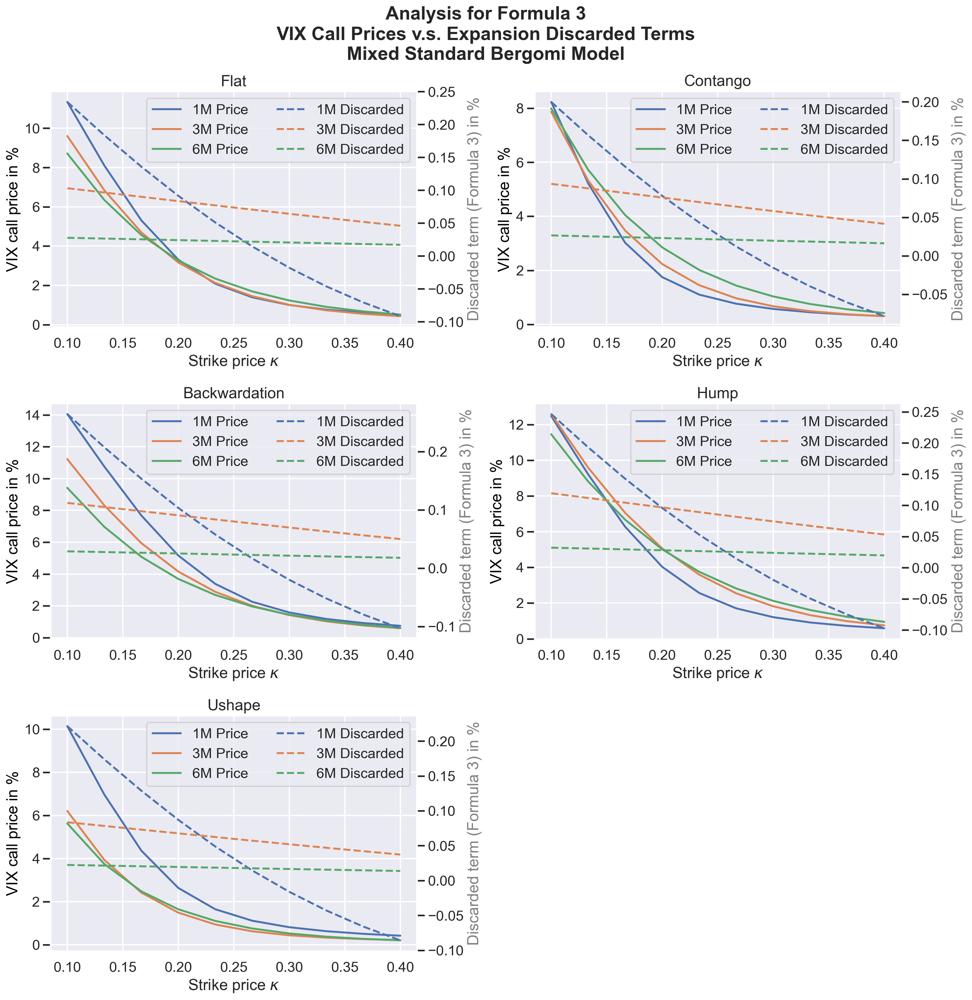

In [25]:
first_s = shapes[0]
first_mat = list(discarded_term_mb[first_s].keys())[0]
formula_names = list(discarded_term_mb[first_s][first_mat].keys())

for target_formula in formula_names:
    
    fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
    axs_flat = axs.flat
    for i, s in enumerate(shapes):
        ax1 = axs_flat[i]
        ax2 = ax1.twinx()
        
        price_dict = vix_call_mb[s]
        disc_dict = discarded_term_mb[s]

        for j, mat in enumerate(price_dict.keys()):
            c = colors[j % len(colors)]
            
            y_price = price_dict[mat] * 100
            ax1.plot(kappas, y_price, color=c, label=f"{mat} Price")

            raw_terms = disc_dict[mat]
            if target_formula in raw_terms:
                y_disc = raw_terms[target_formula] * 100
                
                ax2.plot(kappas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

        ax1.grid(True)
        ax2.grid(False)
        ax1.set_title(f"{s.capitalize()}")
        ax1.set_xlabel(r"Strike price $\kappa$")
        ax1.set_ylabel("VIX call price in %", color='black')
        ax2.set_ylabel(f"Discarded term ({target_formula}) in %", color='gray')
        lines_1, labels_1 = ax1.get_legend_handles_labels()
        lines_2, labels_2 = ax2.get_legend_handles_labels()
        ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

    for j in range(n_shapes, len(axs_flat)):
        axs_flat[j].axis("off")

    fig.suptitle(f"Analysis for {target_formula}\nVIX Call Prices v.s. Expansion Discarded Terms\nMixed Standard Bergomi Model", 
                 fontweight='bold', y=0.9)

    plt.tight_layout(rect=[0, 0, 1, 0.92])
    plt.show()

### 2.2 Mixe Rough Bergomi Model

In [26]:
base_params_mrb = {"eta": 1.4, "H": 0.1}
eta2 = 0.7
lbd_rb = 0.3

models_mrb = {
    s: RoughBergomi(
        **base_params_mrb, 
        xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
    )
    for s in shapes
}

In [27]:
vix_call_mrb = {}
discarded_term_mrb = {}
for s in shapes:
    vix_call_mrb[s] = {}
    discarded_term_mrb[s] = {}
    
    for mat, T in maturities.items():

        price, term = models_mrb[s].vix_opt_price_expan_mixed(kappas, T, rule, eta2, lbd_rb, 1, n_max, n_mc, return_opt="all")

        vix_call_mrb[s][mat] = price
        discarded_term_mrb[s][mat] = term

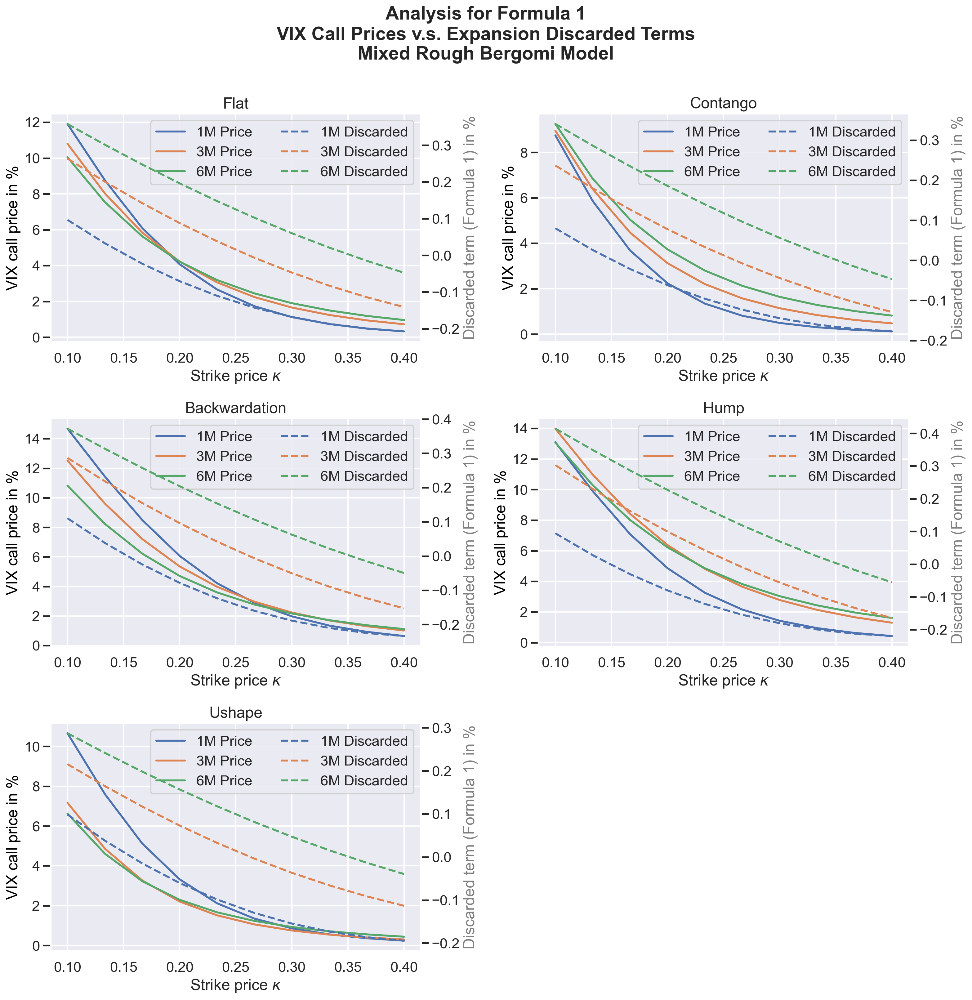

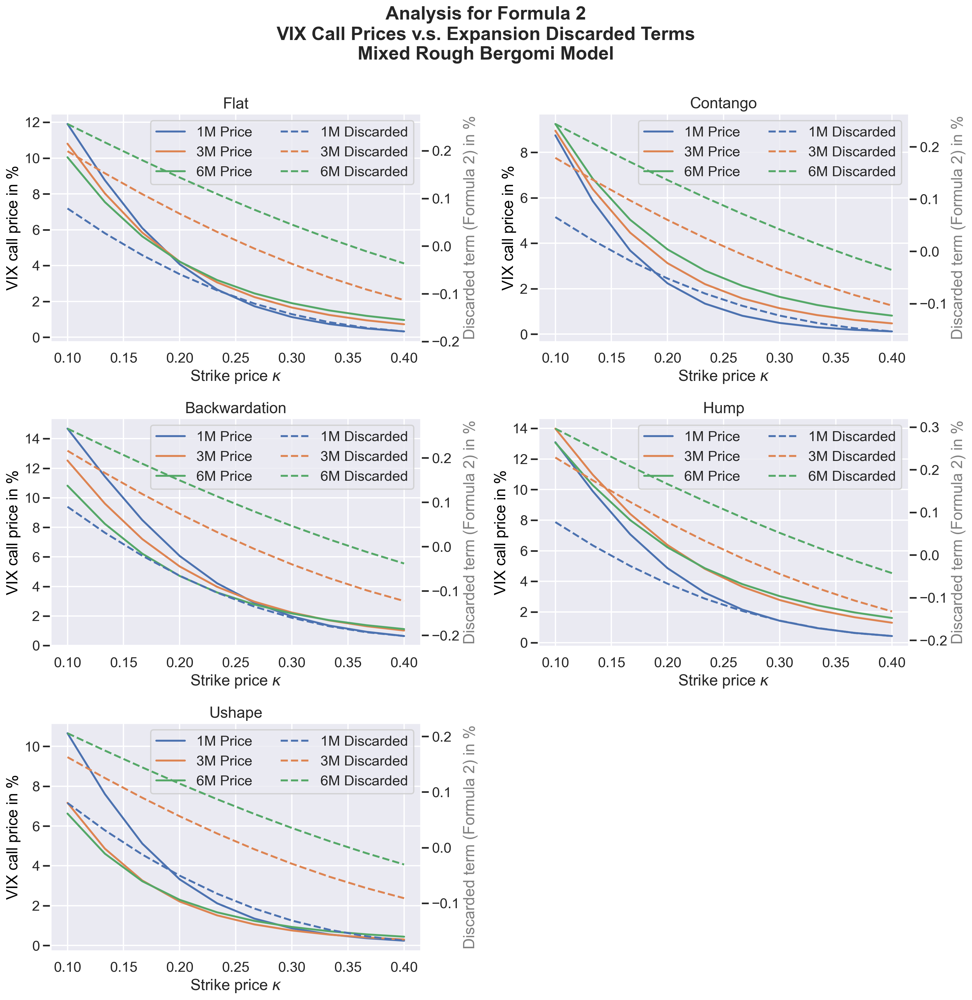

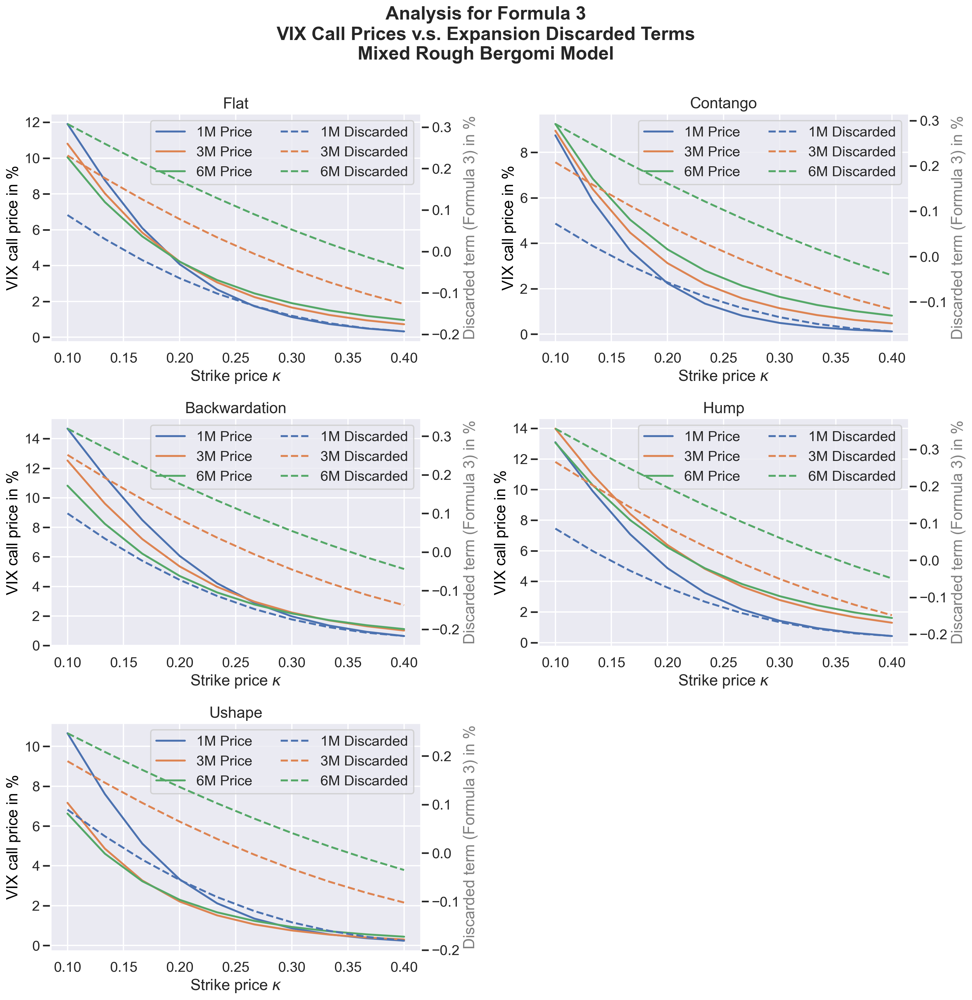

In [28]:
first_s = shapes[0]
first_mat = list(discarded_term_mrb[first_s].keys())[0]
formula_names = list(discarded_term_mrb[first_s][first_mat].keys())

for target_formula in formula_names:
    
    fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
    axs_flat = axs.flat

    for i, s in enumerate(shapes):
        ax1 = axs_flat[i]
        ax2 = ax1.twinx()
        
        price_dict = vix_call_mrb[s]
        disc_dict = discarded_term_mrb[s]

        for j, mat in enumerate(price_dict.keys()):
            c = colors[j % len(colors)]
            
            y_price = price_dict[mat] * 100
            ax1.plot(kappas, y_price, color=c, label=f"{mat} Price")
            
            raw_terms = disc_dict[mat]
            if target_formula in raw_terms:

                y_disc = raw_terms[target_formula] * 100
                ax2.plot(kappas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

        ax1.grid(True)
        ax2.grid(False)
        ax1.set_title(f"{s.capitalize()}")
        ax1.set_xlabel(r"Strike price $\kappa$")
        ax1.set_ylabel("VIX call price in %", color='black')
        ax2.set_ylabel(f"Discarded term ({target_formula}) in %", color='gray')
        lines_1, labels_1 = ax1.get_legend_handles_labels()
        lines_2, labels_2 = ax2.get_legend_handles_labels()
        ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

    for j in range(n_shapes, len(axs_flat)):
        axs_flat[j].axis("off")

    fig.suptitle(f"Analysis for {target_formula}\nVIX Call Prices v.s. Expansion Discarded Terms\nMixed Rough Bergomi Model", 
                 fontweight='bold', y=0.9)

    plt.tight_layout(rect=[0, 0, 1, 0.9])
    plt.show()

## 3. Extra Tests for Parameter Settings That Lead to a Poor VIX Implied Volatility Approximation

### 3.1 Mixed Standard Bergomi Model

In [29]:
base_params_mb = {"omega": 0.5, "k": 1}
mat_values = list(maturities.values())
omega2 = 6
lbd_b = 0.3

models_mb = {
    s: StandardBergomi(
        **base_params_mb, 
        xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
    )
    for s in shapes
}

In [30]:
vix_call_mb = {}
discarded_term_mb = {}

for s in shapes:
    vix_call_mb[s] = {}
    discarded_term_mb[s] = {}
    
    for mat, T in maturities.items():

        price, term = models_mb[s].vix_opt_price_expan_mixed(kappas, T, rule, omega2, lbd_b, 1, n_max, n_mc, return_opt="all")

        vix_call_mb[s][mat] = price
        discarded_term_mb[s][mat] = term

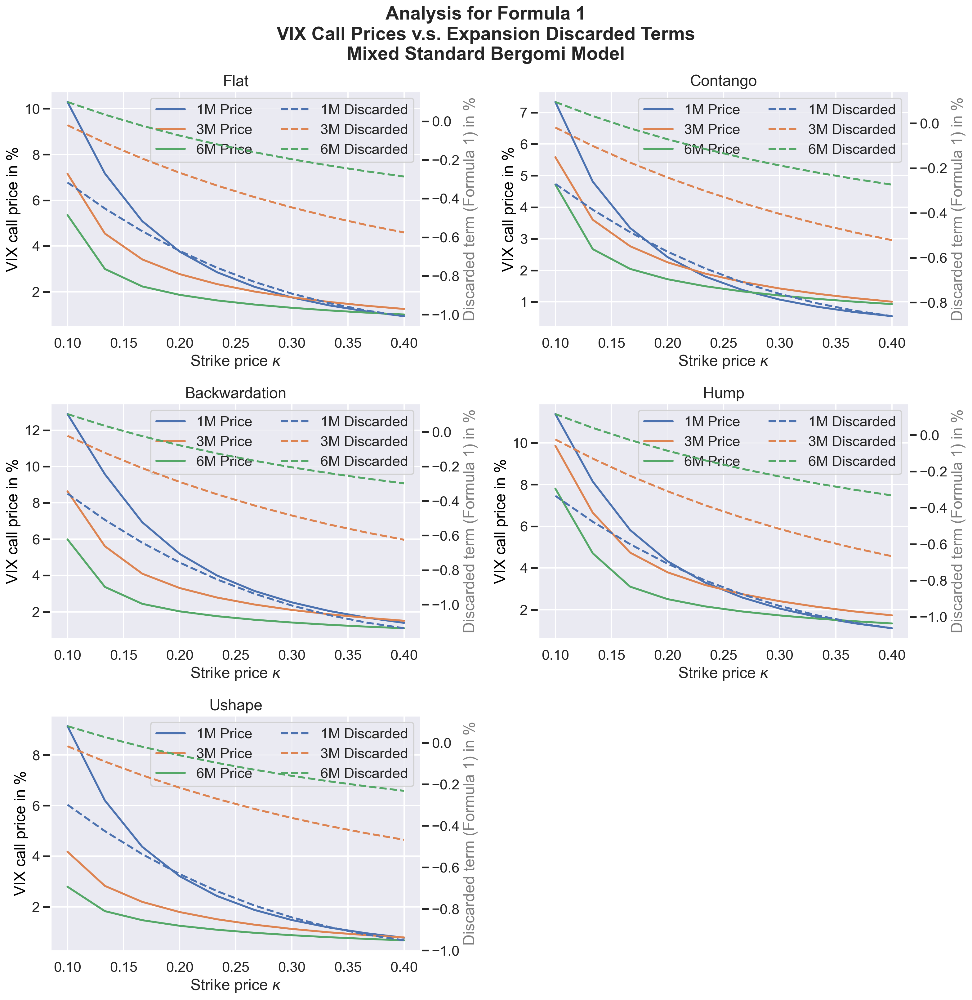

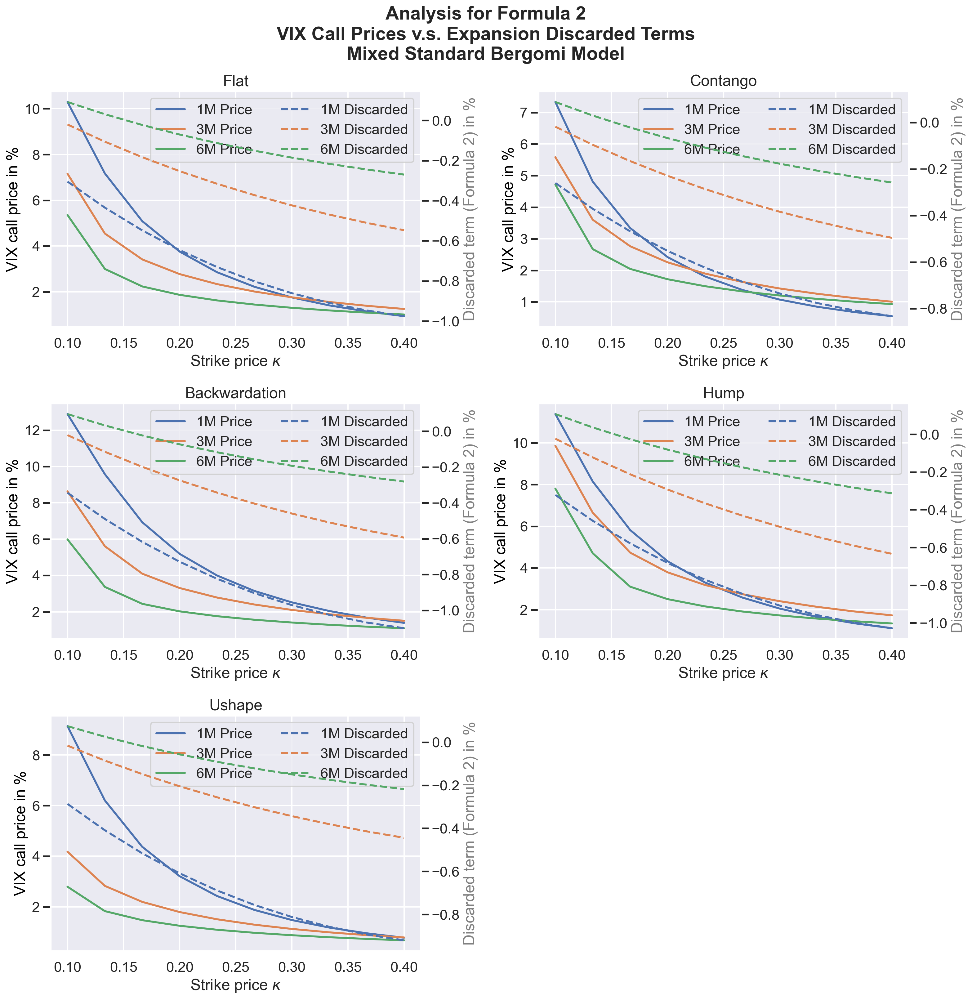

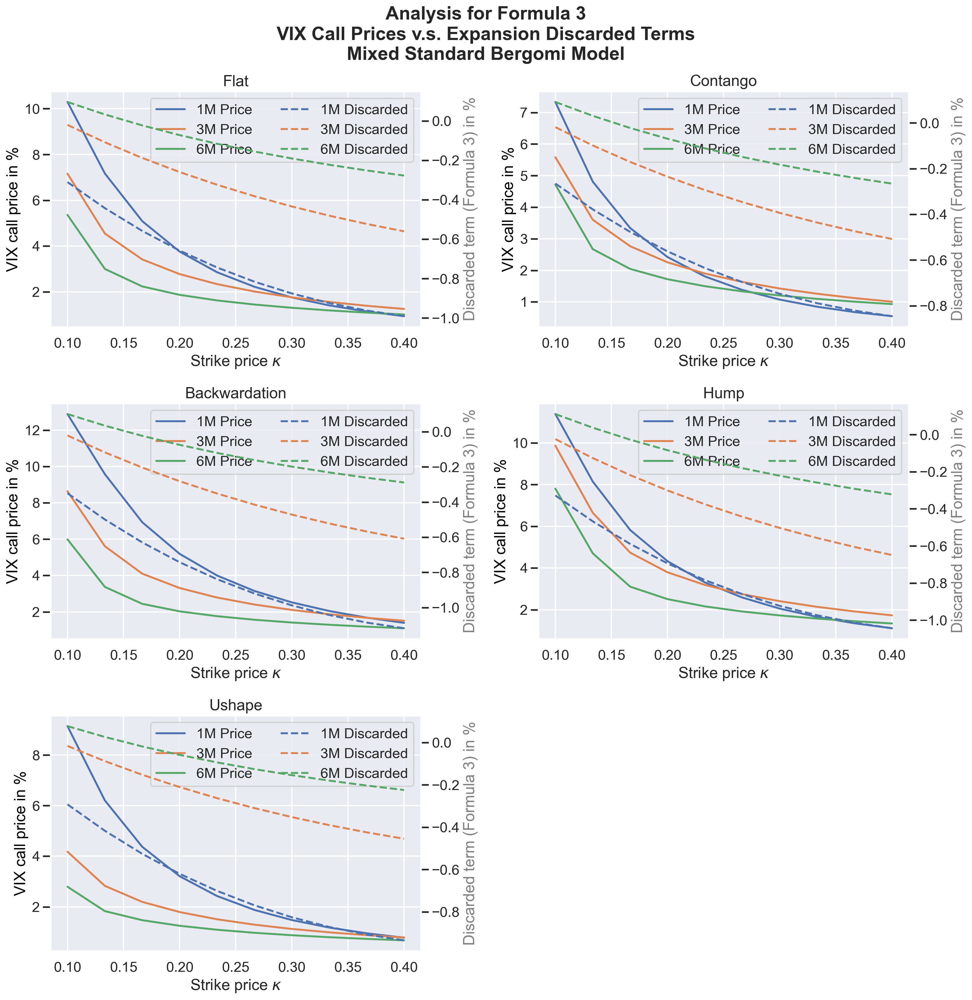

In [31]:
first_s = shapes[0]
first_mat = list(discarded_term_mb[first_s].keys())[0]
formula_names = list(discarded_term_mb[first_s][first_mat].keys())

for target_formula in formula_names:
    
    fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
    axs_flat = axs.flat

    for i, s in enumerate(shapes):
        ax1 = axs_flat[i]
        ax2 = ax1.twinx()
        
        price_dict = vix_call_mb[s]
        disc_dict = discarded_term_mb[s]

        for j, mat in enumerate(price_dict.keys()):
            c = colors[j % len(colors)]
            
            y_price = price_dict[mat] * 100
            ax1.plot(kappas, y_price, color=c, label=f"{mat} Price")

            raw_terms = disc_dict[mat]
            if target_formula in raw_terms:
                y_disc = raw_terms[target_formula] * 100
                
                ax2.plot(kappas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

        ax1.grid(True)
        ax2.grid(False)
        ax1.set_title(f"{s.capitalize()}")
        ax1.set_xlabel(r"Strike price $\kappa$")
        ax1.set_ylabel("VIX call price in %", color='black')
        ax2.set_ylabel(f"Discarded term ({target_formula}) in %", color='gray')
        lines_1, labels_1 = ax1.get_legend_handles_labels()
        lines_2, labels_2 = ax2.get_legend_handles_labels()
        ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

    for j in range(n_shapes, len(axs_flat)):
        axs_flat[j].axis("off")

    fig.suptitle(f"Analysis for {target_formula}\nVIX Call Prices v.s. Expansion Discarded Terms\nMixed Standard Bergomi Model", 
                 fontweight='bold', y=0.9)

    plt.tight_layout(rect=[0, 0, 1, 0.92])
    plt.show()

### 3.2 Mixed Rough Bergomi Model

In [32]:
base_params_mrb = {"eta": 2, "H": 0.1}
eta2 = 0.2
lbd_rb = 0.4

models_mrb = {
    s: RoughBergomi(
        **base_params_mrb, 
        xi0=lambda u, s=s: xi0_nelson_siegel(u, shape=s)
    )
    for s in shapes
}

In [33]:
vix_call_mrb = {}
discarded_term_mrb = {}
for s in shapes:
    vix_call_mrb[s] = {}
    discarded_term_mrb[s] = {}
    
    for mat, T in maturities.items():

        price, term = models_mrb[s].vix_opt_price_expan_mixed(kappas, T, rule, eta2, lbd_rb, 1, n_max, n_mc, return_opt="all")

        vix_call_mrb[s][mat] = price
        discarded_term_mrb[s][mat] = term

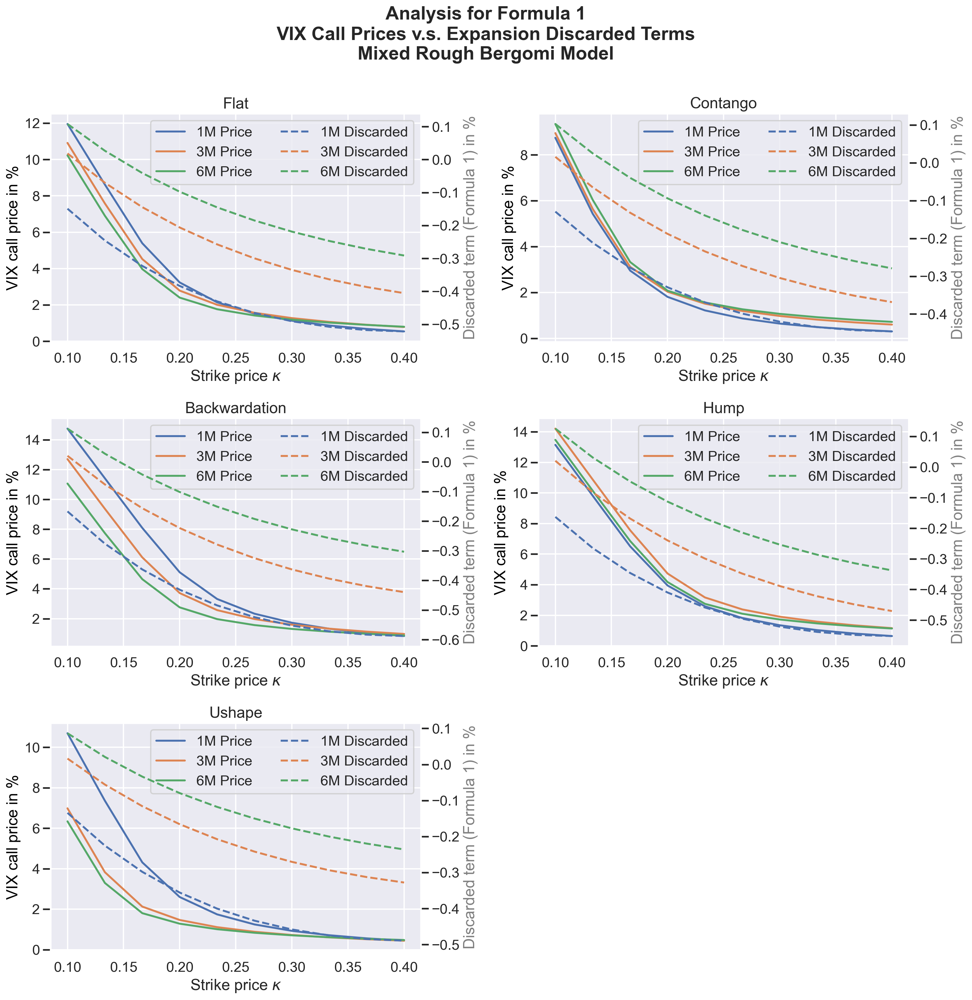

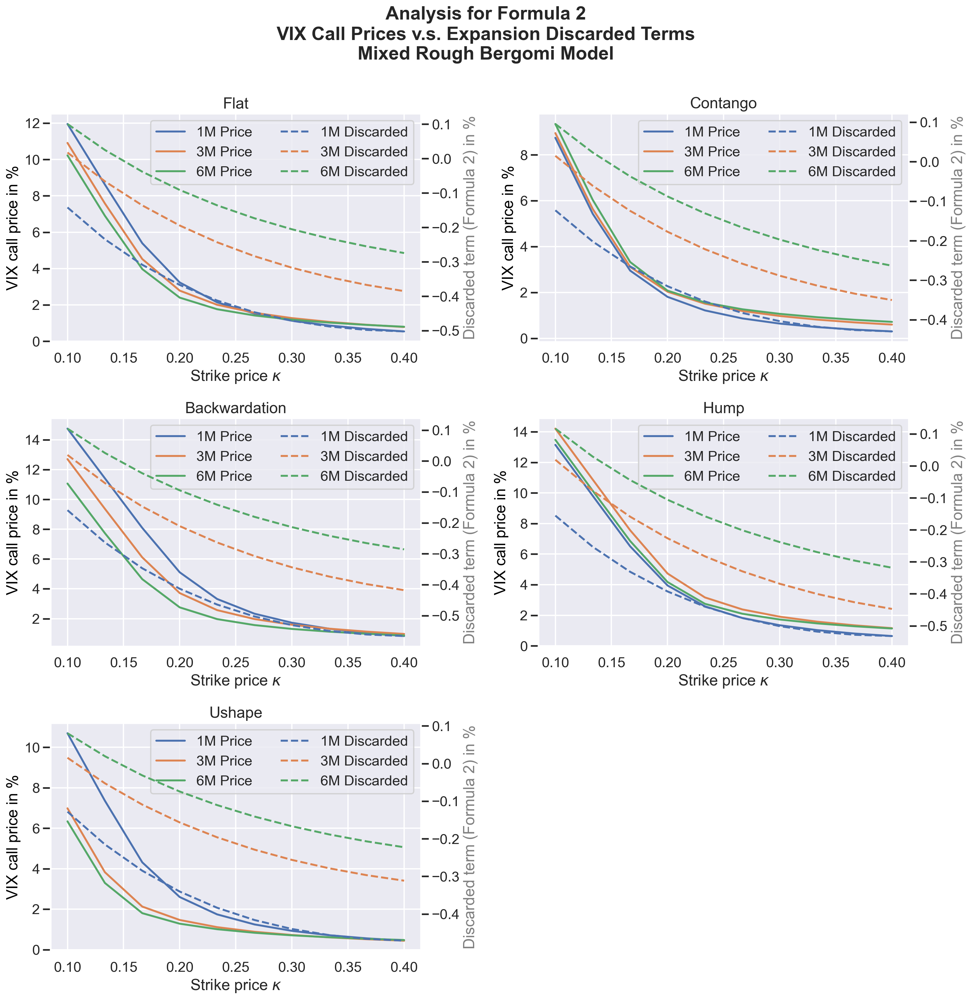

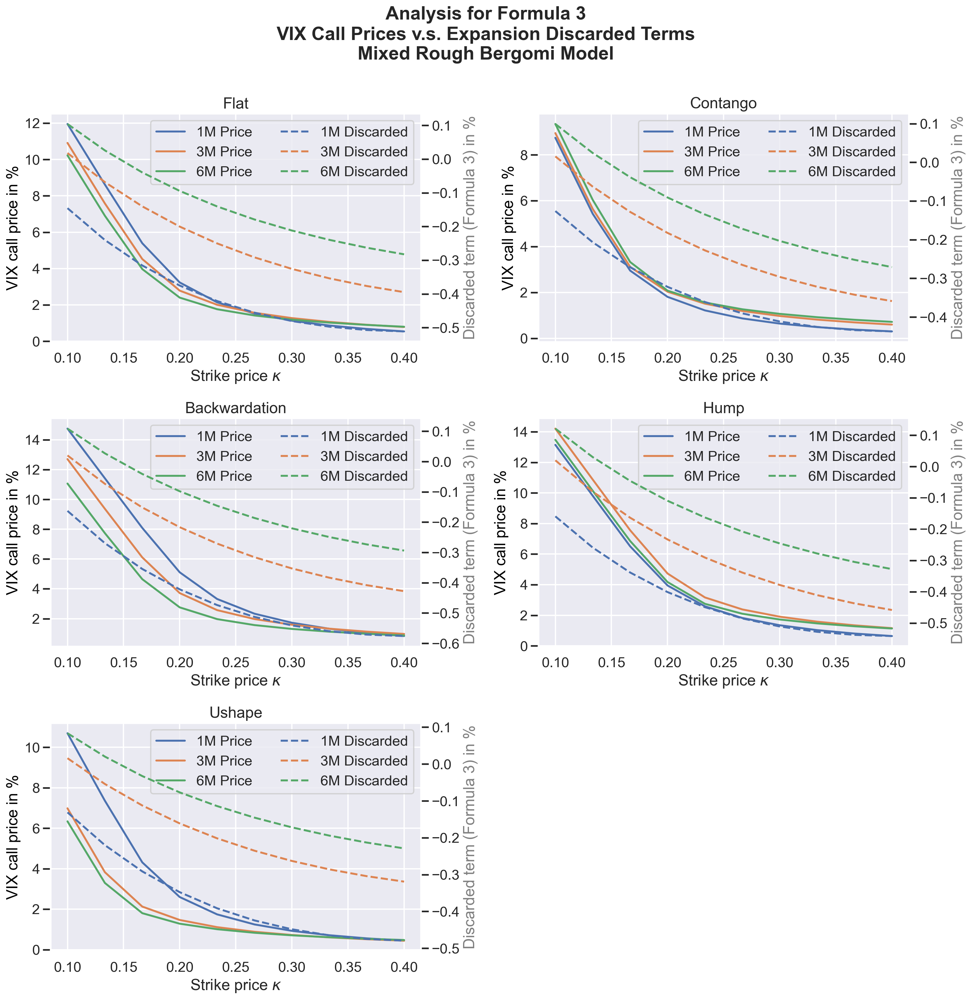

In [34]:
first_s = shapes[0]
first_mat = list(discarded_term_mrb[first_s].keys())[0]
formula_names = list(discarded_term_mrb[first_s][first_mat].keys())

for target_formula in formula_names:
    
    fig, axs = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(16, 6 * n_rows))
    axs_flat = axs.flat

    for i, s in enumerate(shapes):
        ax1 = axs_flat[i]
        ax2 = ax1.twinx()
        
        price_dict = vix_call_mrb[s]
        disc_dict = discarded_term_mrb[s]

        for j, mat in enumerate(price_dict.keys()):
            c = colors[j % len(colors)]
            
            y_price = price_dict[mat] * 100
            ax1.plot(kappas, y_price, color=c, label=f"{mat} Price")
            
            raw_terms = disc_dict[mat]
            if target_formula in raw_terms:

                y_disc = raw_terms[target_formula] * 100
                ax2.plot(kappas, y_disc, color=c, linestyle='--', label=f"{mat} Discarded")

        ax1.grid(True)
        ax2.grid(False)
        ax1.set_title(f"{s.capitalize()}")
        ax1.set_xlabel(r"Strike price $\kappa$")
        ax1.set_ylabel("VIX call price in %", color='black')
        ax2.set_ylabel(f"Discarded term ({target_formula}) in %", color='gray')
        lines_1, labels_1 = ax1.get_legend_handles_labels()
        lines_2, labels_2 = ax2.get_legend_handles_labels()
        ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', ncol=2)

    for j in range(n_shapes, len(axs_flat)):
        axs_flat[j].axis("off")

    fig.suptitle(f"Analysis for {target_formula}\nVIX Call Prices v.s. Expansion Discarded Terms\nMixed Rough Bergomi Model", 
                 fontweight='bold', y=0.9)

    plt.tight_layout(rect=[0, 0, 1, 0.9])
    plt.show()